# Pr-Tmax cross-correlation

Assessment of model Pr-Tmax monthly anomalies cross-correlation 

In [1]:
import warnings
warnings.filterwarnings('ignore')

import sys
import numpy as np
import matplotlib.pyplot as plt
import cmocean
import cartopy.crs as ccrs
import seaborn as sns
from scipy import stats

sys.path.append('/g/data/xv83/users/at2708/bias_adjustment/evaluation/npcp/results')
import utils

In [2]:
def calc_pt_corr(da_p, da_t):
    """Calculate the monthly anomalies for Pr and Tasmax"""
        
    precip_clim = (da_p.groupby("time.month").mean(dim="time"))
    anom_p = da_p.groupby("time.month") - precip_clim
    anom_p_mean = anom_p.mean(dim=['lon', 'lat'])


    tmax_clim = (da_t.groupby("time.month").mean(dim="time"))
    anom_t = da_t.groupby("time.month") - tmax_clim
    anom_t_mean = anom_t.mean(dim=['lon', 'lat'])



    return anom_p_mean, anom_t_mean 

In [3]:
def get_data(gcm, rcm, task):
    """Get data needed for the evaluation"""

    assert gcm in ['ECMWF-ERA5', 'CSIRO-ACCESS-ESM1-5']
    assert rcm in ['BOM-BARPA-R', 'CSIRO-CCAM-2203', 'UQ-DES-CCAM-2105']
    assert task in ['historical', 'xvalidation']

    if gcm == 'ECMWF-ERA5':
        start_date = '2000-01-01' if task == 'xvalidation' else '1980-01-01'
    else:
        start_date = '1990-01-01' if task == 'xvalidation' else '1980-01-01' 
    end_date = '2019-12-31'
    
    da_dict = {}
    
    da_dict['obs_p'] = utils.get_npcp_data(
        'pr',
        'observations',
        'AGCD',
        'raw',
        'task-reference',
        start_date,
        end_date,
        'AU'
    )

    da_dict['obs_t'] = utils.get_npcp_data(
        'tasmax',
        'observations',
        'AGCD',
        'raw',
        'task-reference',
        start_date,
        end_date,
        'AU'
    )
   
    da_dict['gcm_p'] = utils.get_npcp_data(
        'pr',
        gcm,
        'GCM',
        'raw',
        'task-reference',
        start_date,
        end_date,
        'AU'
    )

    da_dict['gcm_t'] = utils.get_npcp_data(
        'tasmax',
        gcm,
        'GCM',
        'raw',
        'task-reference',
        start_date,
        end_date,
        'AU'
    )
    
    da_dict['rcm_raw_p'] = utils.get_npcp_data(
        'pr',
        gcm,
        rcm,
        'raw',
        'task-reference',
        start_date,
        end_date,
        'AU'
    )

    da_dict['rcm_raw_t'] = utils.get_npcp_data(
        'tasmax',
        gcm,
        rcm,
        'raw',
        'task-reference',
        start_date,
        end_date,
        'AU'
    )
    
    da_dict['rcm_ecdfm_p'] = utils.get_npcp_data(
        'pr',
        gcm,
        rcm,
        'ecdfm',
        f'task-{task}',
        start_date,
        end_date,
        'AU'
    )

    da_dict['rcm_ecdfm_t'] = utils.get_npcp_data(
        'tasmax',
        gcm,
        rcm,
        'ecdfm',
        f'task-{task}',
        start_date,
        end_date,
        'AU'
    )


    da_dict['rcm_qme_p'] = utils.get_npcp_data(
        'pr',
        gcm,
        rcm,
        'qme',
        f'task-{task}',
        start_date,
        end_date,
        'AU'
    )

    da_dict['rcm_qme_t'] = utils.get_npcp_data(
        'tasmax',
        gcm,
        rcm,
        'qme',
        f'task-{task}',
        start_date,
        end_date,
        'AU'
    )
    if task == 'xvalidation':
        da_dict['rcm_qdm_p'] = utils.get_npcp_data(
            'pr',
            gcm,
            rcm,
            'qdm',
            f'task-{task}',
            start_date,
            end_date,
            'AU'
        )
        da_dict['rcm_qdm_t'] = utils.get_npcp_data(
            'tasmax',
            gcm,
            rcm,
            'qdm',
            f'task-{task}',
            start_date,
            end_date,
            'AU'
        )
    # TODO: Add additional bias correction methods as data becomes available 

    return da_dict

In [4]:
def plot_mean_bias(ax, da_p, da_t, model_name, month, ob_fractions=None):
    """Plot the mean bias for a particular model"""

    da_p = utils.clip_data(da_p, utils.get_aus_shape())
    da_t = utils.clip_data(da_t, utils.get_aus_shape())
    if ob_fractions is not None:
        da_p = utils.mask_by_pr_ob_fraction(da_p, ob_fractions, threshold=0.9) 
        da_t = utils.mask_by_pr_ob_fraction(da_t, ob_fractions, threshold=0.9) 
    anom_p_mean, anom_t_mean = calc_pt_corr(da_p, da_t)
    
    month_idxs_t=anom_t_mean.groupby('time.month').groups
    month_idxs_p=anom_p_mean.groupby('time.month').groups


       
    def corrfunc(ax, x, y, **kws):
        finite_mask = np.isfinite(x) & np.isfinite(y)
        x_finite = x[finite_mask]
        y_finite = y[finite_mask]
        r, _ = stats.pearsonr(x_finite, y_finite)
        ax.annotate("r = {:.2f}".format(r),
                    xy=(.05, .05), xycoords=ax.transAxes, fontsize=16)
    if month == 'jan':
        x_data = anom_t_mean.isel(time=month_idxs_t[1]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[1]).values.flatten()
    elif month == 'feb':
        x_data = anom_t_mean.isel(time=month_idxs_t[2]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[2]).values.flatten()
    elif month == 'mar':
        x_data = anom_t_mean.isel(time=month_idxs_t[3]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[3]).values.flatten()
    elif month == 'apr':
        x_data = anom_t_mean.isel(time=month_idxs_t[4]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[4]).values.flatten()
    elif month == 'may':
        x_data = anom_t_mean.isel(time=month_idxs_t[5]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[5]).values.flatten()
    elif month == 'jun':
        x_data = anom_t_mean.isel(time=month_idxs_t[6]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[6]).values.flatten()
    elif month == 'jul':
        x_data = anom_t_mean.isel(time=month_idxs_t[7]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[7]).values.flatten()
    elif month == 'aug':
        x_data = anom_t_mean.isel(time=month_idxs_t[8]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[8]).values.flatten()
    elif month == 'sep':
        x_data = anom_t_mean.isel(time=month_idxs_t[9]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[9]).values.flatten()
    elif month == 'oct':
        x_data = anom_t_mean.isel(time=month_idxs_t[10]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[10]).values.flatten()
    elif month == 'nov':
        x_data = anom_t_mean.isel(time=month_idxs_t[11]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[11]).values.flatten()
    elif month == 'dec':
        x_data = anom_t_mean.isel(time=month_idxs_t[12]).values.flatten()
        y_data  =anom_p_mean.isel(time=month_idxs_p[12]).values.flatten()
    else:
        print('Invalid month')
        return

    # x_data_ = x_data[~np.isnan(x_data) & ~np.isnan(y_data) & np.isfinite(x_data) & np.isfinite(y_data)]
    # y_data_ = y_data[~np.isnan(y_data) & ~np.isnan(x_data) & np.isfinite(x_data) & np.isfinite(y_data)]
    # sns.scatterplot(ax=ax, x = x_data_, y = y_data_,alpha=0.3)
    sns.kdeplot(ax=ax, x = x_data, y = y_data)
    corrfunc(ax, x = x_data, y = y_data)
    
    ax.set_title(model_name)
    ax.tick_params(axis='x', labelsize=16)
    ax.tick_params(axis='y', labelsize=16)
    ax.set_xlim(-10,10)
    ax.set_ylim(-8,8)
    ax.set_xlabel('Tasmax anomalies ($^\circ$C/month)', fontsize=16)
    ax.set_ylabel('Pr anomalies (mm/month)', fontsize=16)
    ax.axhline(y=0, color='gray', linestyle='--', linewidth=0.7)
    ax.axvline(x=0, color='gray', linestyle='--', linewidth=0.7)



In [5]:
def plot_comparison(gcm, rcm, task, save_outfile=False):
    """Plot the complete comparison"""

    if save_outfile:
        outfile = f'PT_cross_correlation_task-{task}_{gcm}_{rcm}.png'
    else:
        outfile = None

    da_dict = get_data(gcm, rcm, task)

    months= ['jan','feb','mar','apr','may','jun','jul','aug','sep','oct','nov','dec']
        
    # if var == 'pr':
    #     ob_fractions = utils.get_pr_weights(gcm, task)
    # else:
    #     ob_fractions = None
    ob_fractions = utils.get_pr_weights(gcm, task)

    ncols = 6 if task == 'xvalidation' else 5   
    rows, cols = len(months), ncols

    fig, axs = plt.subplots(rows, cols, figsize=[7*cols, 6*rows])
    
    for row, month in enumerate(months):

        ax1 = axs[row, 0]
        ax2 = axs[row, 1]
        ax3 = axs[row, 2]
        ax4 = axs[row, 3]
        ax5 = axs[row, 4]
        if task == 'xvalidation':
            ax6 = axs[row, 5]

         # Plot AGCD
        plot_mean_bias(ax1, da_dict['obs_p'],da_dict['obs_t'], 'AGCD', month,  ob_fractions=ob_fractions)
        ax1.set_title(f'AGCD ({month.upper()})', fontsize=16)
        
        # Plot GCM 
        plot_mean_bias(ax2, da_dict['gcm_p'],da_dict['gcm_t'], gcm, month,  ob_fractions=ob_fractions)
        ax2.set_title(f'{gcm} ({month.upper()})', fontsize=16)

        # Plot RCM raw 
        plot_mean_bias(ax3, da_dict['rcm_raw_p'], da_dict['rcm_raw_t'], f'{rcm} (raw)', month,  ob_fractions=ob_fractions)
        ax3.set_title(f'{rcm} (raw) ({month.upper()})', fontsize=16)

        # Plot RCM bias corrected 
        plot_mean_bias(ax4, da_dict['rcm_ecdfm_p'], da_dict['rcm_ecdfm_t'],  f'{rcm} (ecdfm)', month,  ob_fractions=ob_fractions)
        ax4.set_title(f'{rcm} (ecdfm) ({month.upper()})', fontsize=16)

        plot_mean_bias(ax5, da_dict['rcm_qme_p'], da_dict['rcm_qme_t'],  f'{rcm} (qme)', month,  ob_fractions=ob_fractions)
        ax5.set_title(f'{rcm} (qme) ({month.upper()})', fontsize=16)

        if task == 'xvalidation':
            plot_mean_bias(ax6, da_dict['rcm_qdm_p'], da_dict['rcm_qdm_t'],  f'{rcm} (qdm)', month,  ob_fractions=ob_fractions)
            ax6.set_title(f'{rcm} (qdm) ({month.upper()})', fontsize=16)
    
    if gcm == 'ECMWF-ERA5':
        start_year = '2000' if task == 'xvalidation' else '1980'
    else:
        start_year = '1990' if task == 'xvalidation' else '1980'
    
    plt.suptitle(f' Precip-Tmax cross-correlation of monthly anomalies in {start_year}-2019', fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.98])
    plt.show()

    if outfile:
        print(outfile)
        plt.savefig(outfile, dpi=300, bbox_inches='tight')
    plt.show()

# task-historical
Bias corrected data for the 1980-2019 period, using 1980-2019 as a training period.

### ERA5

In [ ]:
plot_comparison('ECMWF-ERA5', 'BOM-BARPA-R', 'historical')

In [ ]:
plot_comparison('ECMWF-ERA5', 'CSIRO-CCAM-2203', 'historical')

In [ ]:
plot_comparison('ECMWF-ERA5', 'UQ-DES-CCAM-2105', 'historical')

### ACCESS-ESM1-5

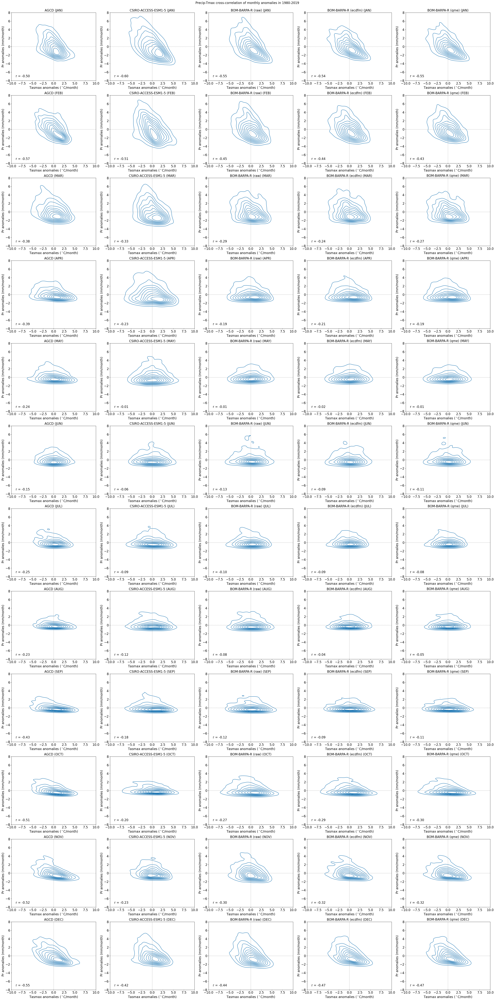

PT_cross_correlation_task-historical_CSIRO-ACCESS-ESM1-5_BOM-BARPA-R.png


<Figure size 640x480 with 0 Axes>

In [50]:
plot_comparison('CSIRO-ACCESS-ESM1-5', 'BOM-BARPA-R', 'historical')

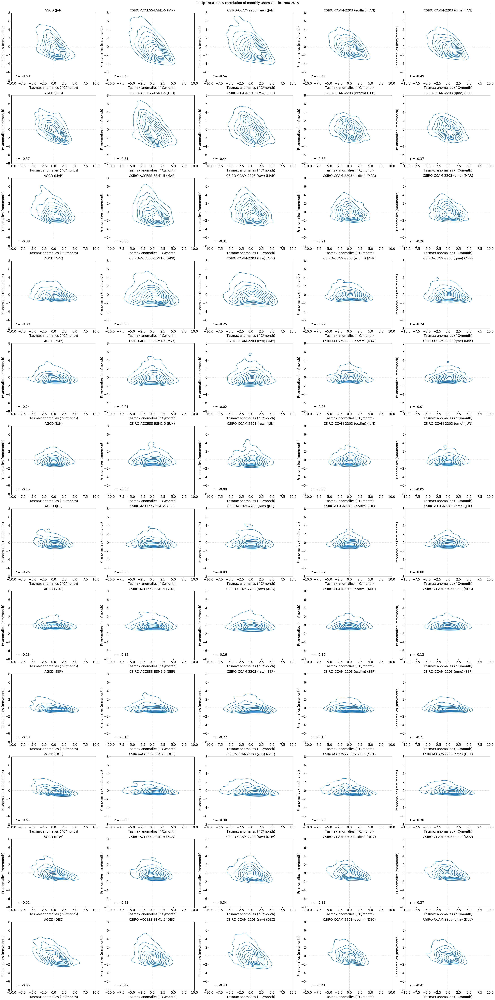

In [6]:
plot_comparison('CSIRO-ACCESS-ESM1-5', 'CSIRO-CCAM-2203', 'historical')

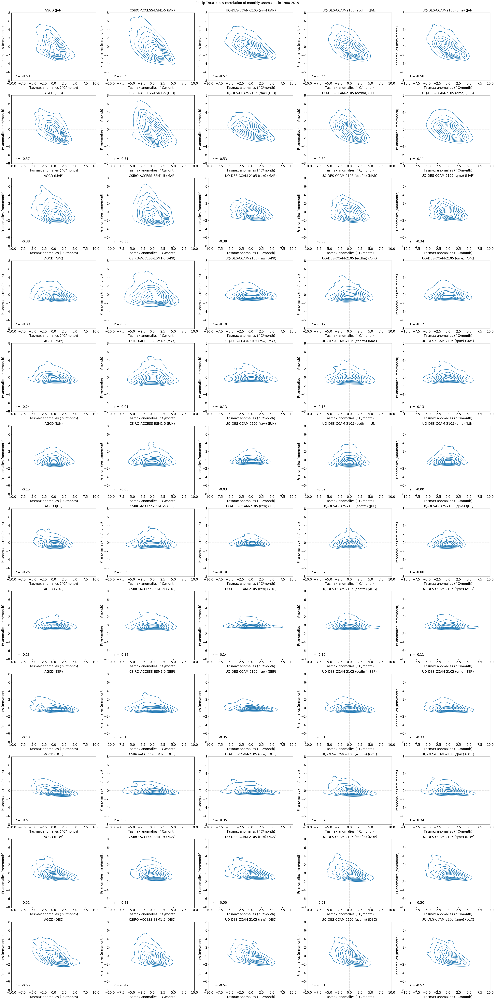

In [7]:
plot_comparison('CSIRO-ACCESS-ESM1-5', 'UQ-DES-CCAM-2105', 'historical')

# task-xvalidation

### ERA5
Bias corrected data for the 2000-2019 period, using 1980-1999 as a training period.

In [ ]:
plot_comparison('ECMWF-ERA5', 'BOM-BARPA-R', 'xvalidation')

In [ ]:
plot_comparison('ECMWF-ERA5', 'CSIRO-CCAM-2203', 'xvalidation')

In [ ]:
plot_comparison('ECMWF-ERA5', 'UQ-DES-CCAM-2105', 'xvalidation')

### ACCESS-ESM1-5
Bias corrected data for the 1990-2019 period, using 1960-1989 as a training period.

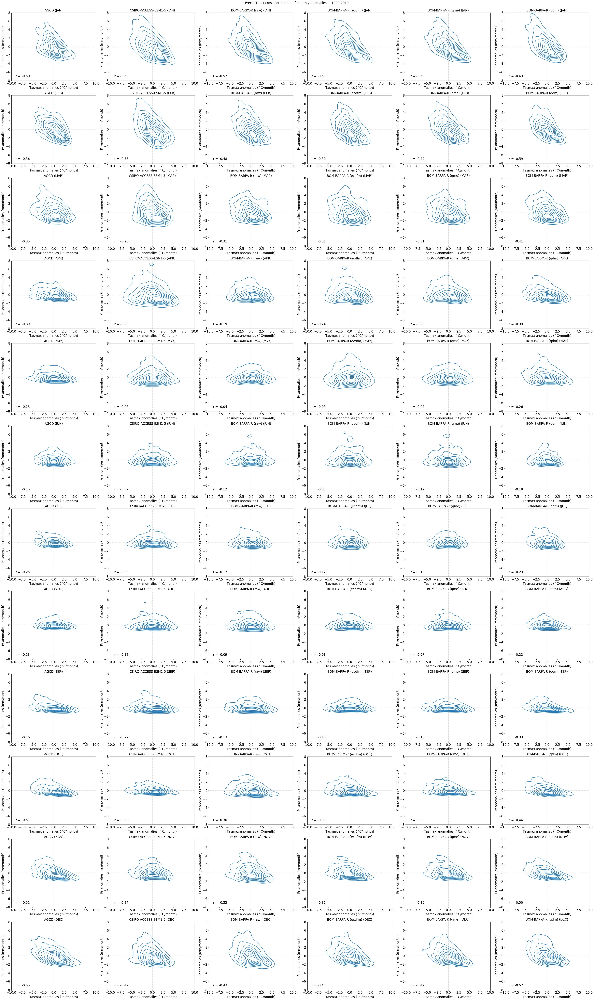

PT_cross_correlation_task-xvalidation_CSIRO-ACCESS-ESM1-5_BOM-BARPA-R.png


<Figure size 640x480 with 0 Axes>

In [8]:
plot_comparison('CSIRO-ACCESS-ESM1-5', 'BOM-BARPA-R', 'xvalidation')

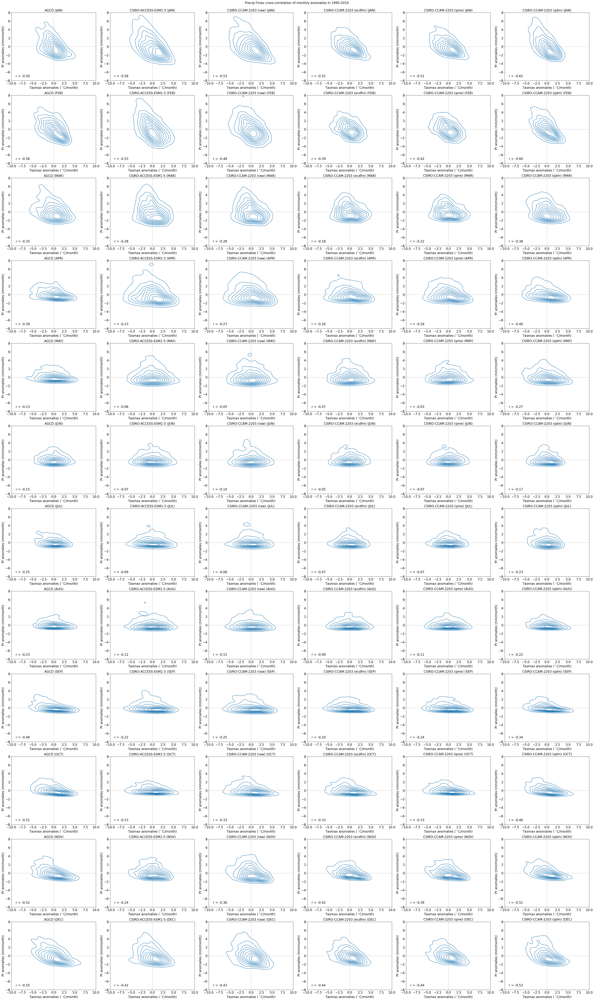

In [7]:
plot_comparison('CSIRO-ACCESS-ESM1-5', 'CSIRO-CCAM-2203', 'xvalidation')

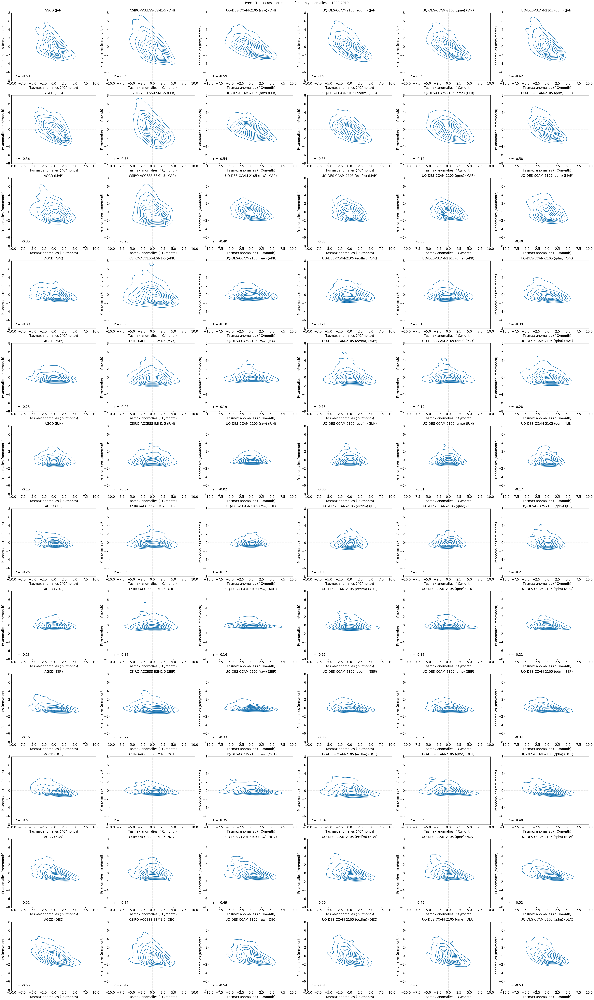

In [6]:
plot_comparison('CSIRO-ACCESS-ESM1-5', 'UQ-DES-CCAM-2105', 'xvalidation')